In [10]:
from panel_segmentation import utils
import glob
import matplotlib.pyplot as plt
from PIL import Image
from ultralytics import YOLO
import os
import pandas as pd
import folium

# Run the SOL-Searcher Pipeline on an Example Area

Take a gridded set of images of a small area and visualize them.

In [11]:
# Pull an area of images in the Austin metro area to run through the SOL-Searcher model. Use the generate_satellite_imagery_grid() function to do this.
northwest_lat, northwest_lon =  30.304107, -97.708710
southeast_lat, southeast_lon =  30.299329, -97.697781
google_maps_api_key = "YOUR_API_KEY_HERE"
zoom_level = 19
file_save_folder = "./panel_segmentation/examples/sol-searcher_data_examples"
grid_info_list = utils.generate_satellite_imagery_grid(northwest_lat, northwest_lon,
                                                       southeast_lat, southeast_lon,
                                                       google_maps_api_key,
                                                       zoom_level,
                                                       file_save_folder,
                                                       lat_lon_distance=.0014)

File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!
File already pulled!


Visualize some of the imagery in the grid as reference.

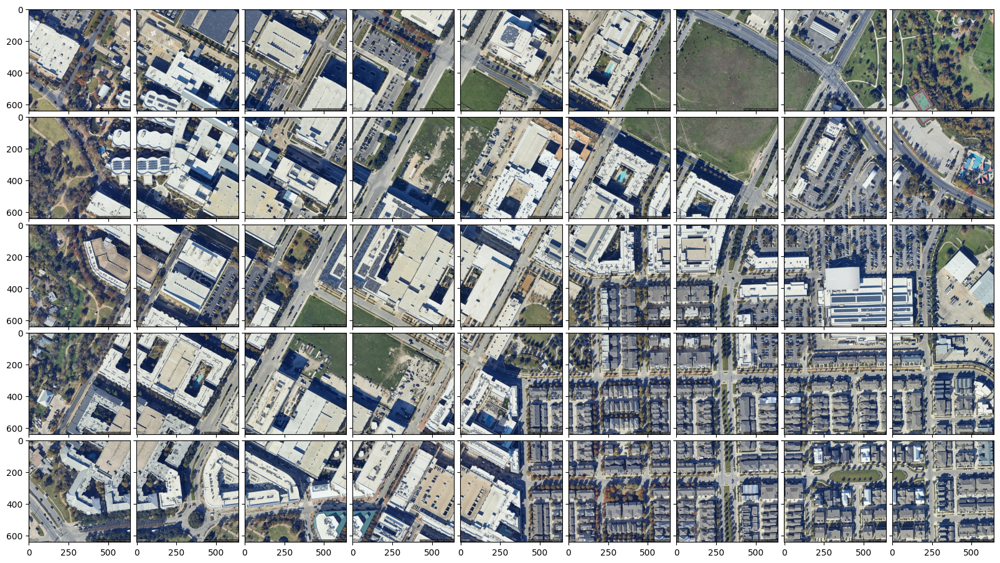

In [12]:
plot = utils.visualize_satellite_imagery_grid(grid_info_list, file_save_folder)
plt.show()

Let's load in the SOL-searcher algorithm and run some imagery through it.

In [13]:
sol_searcher_model_path = "./panel_segmentation/models/sol_searcher.pt"
sol_searcher_model = YOLO(sol_searcher_model_path)
grid_files = glob.glob(os.path.join(file_save_folder, "*.png"))
# Run inference on the example images
results = sol_searcher_model(grid_files, overlap_mask=False,device="cpu")


0: 640x640 11 panels, 2104.5ms
1: 640x640 10 panels, 2104.5ms
2: 640x640 8 panels, 2104.5ms
3: 640x640 15 panels, 2104.5ms
4: 640x640 11 panels, 2104.5ms
5: 640x640 (no detections), 2104.5ms
6: 640x640 (no detections), 2104.5ms
7: 640x640 (no detections), 2104.5ms
8: 640x640 (no detections), 2104.5ms
9: 640x640 5 panels, 2104.5ms
10: 640x640 11 panels, 2104.5ms
11: 640x640 15 panels, 2104.5ms
12: 640x640 29 panels, 2104.5ms
13: 640x640 10 panels, 2104.5ms
14: 640x640 1 panel, 2104.5ms
15: 640x640 (no detections), 2104.5ms
16: 640x640 (no detections), 2104.5ms
17: 640x640 1 panel, 2104.5ms
18: 640x640 5 panels, 2104.5ms
19: 640x640 11 panels, 2104.5ms
20: 640x640 12 panels, 2104.5ms
21: 640x640 10 panels, 2104.5ms
22: 640x640 (no detections), 2104.5ms
23: 640x640 9 panels, 2104.5ms
24: 640x640 3 panels, 2104.5ms
25: 640x640 (no detections), 2104.5ms
26: 640x640 (no detections), 2104.5ms
27: 640x640 (no detections), 2104.5ms
28: 640x640 (no detections), 2104.5ms
29: 640x640 (no detectio

Let's visualize some of the result outputs from the model.

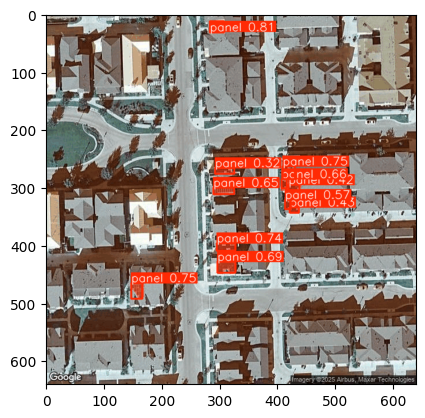

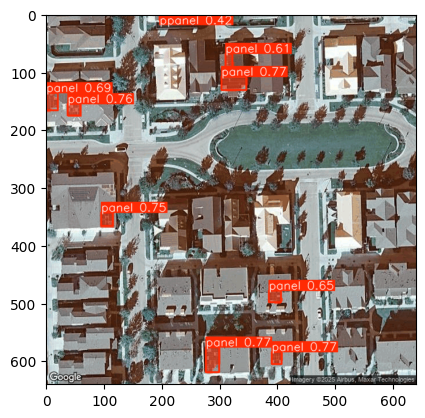

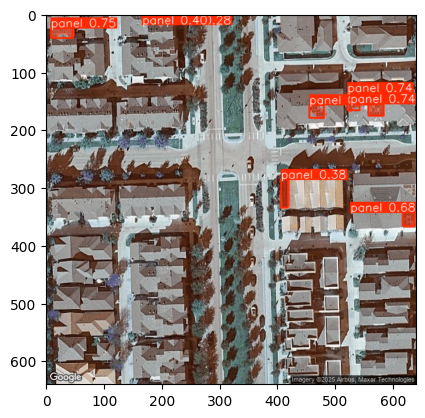

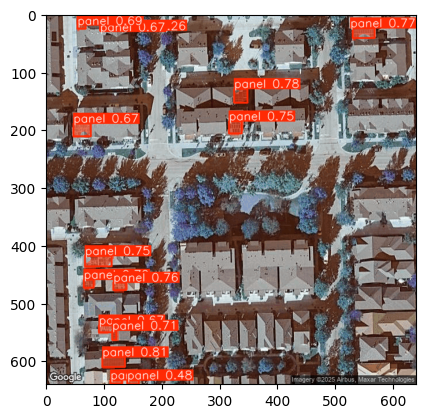

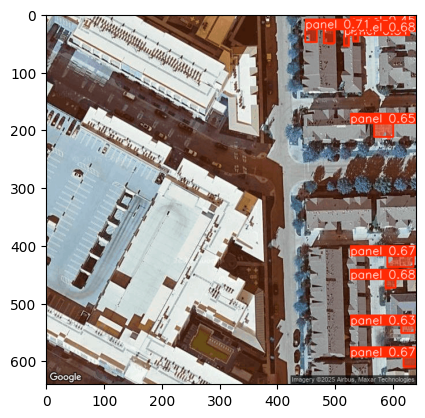

...

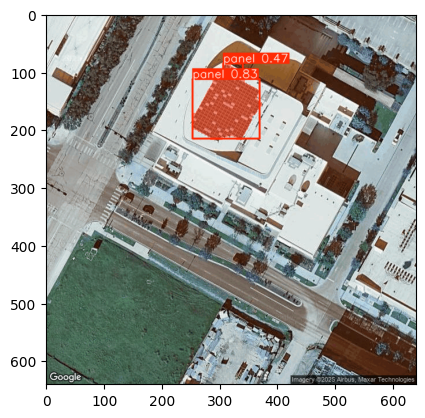

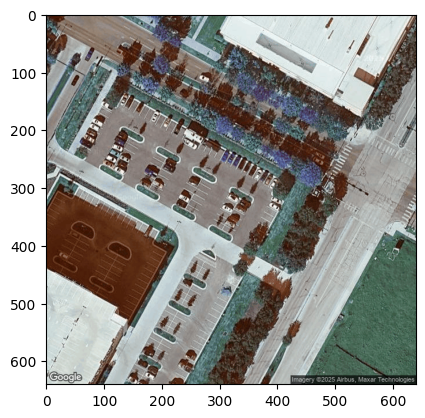

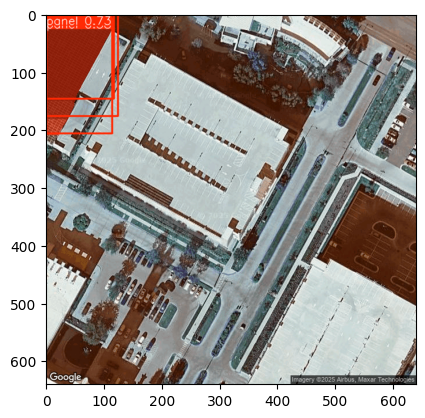

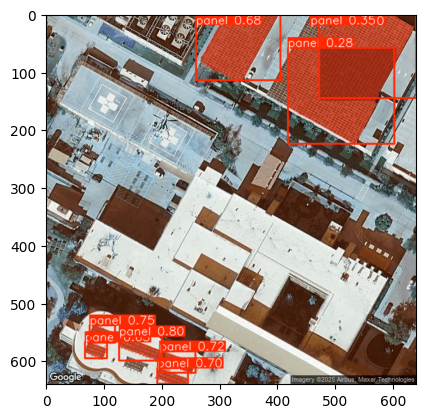

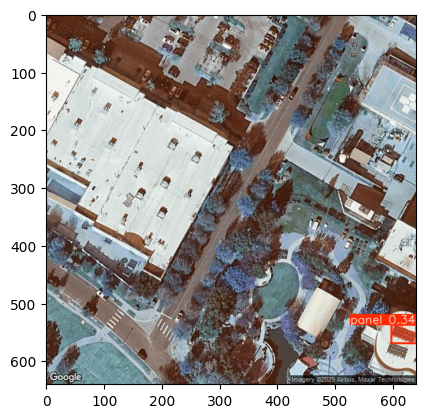

In [14]:
# Visualize inference outputs
for result in results:
    plot = result.plot()
    plt.imshow(plot)
    plt.show()
    plt.close()

We can use the mask outputs from the model to identify the latitude-longitude coordinates of individual installations.

In [6]:
# Loop through each inference result and get the lat-lon coordinates of the centroid of the box outputs
solar_location_list = list()
for result in results:
    file_name = os.path.basename(result.path)
    img_center_lat, img_center_lon = float(file_name.split("_")[0]), float(file_name.split("_")[-1].replace(".png", ""))
    image_x_pixels, image_y_pixels = result.orig_shape
    boxes = result.boxes
    for box in boxes:
        np_box = box.xyxy.numpy()[0]
        box_lat, box_lon = utils.get_inference_box_lat_lon_coordinates(np_box, img_center_lat, img_center_lon,
                                                                       image_x_pixels, image_y_pixels,
                                                                       zoom_level)
        solar_location_list.append((box_lat, box_lon))

If we want to associate individual installations to specific buildings, we can use Google's geocoding API to get individual addresses for each PV installation.

In [7]:
solar_install_address_list = list()
for lat_lon_coords in solar_location_list:
    latitude, longitude = lat_lon_coords[0], lat_lon_coords[1]
    # Look up the address associated with lat-lon coordinate
    solar_install_address = utils.generate_address(latitude, longitude, google_maps_api_key)
    solar_install_address_list.append({"latitude": latitude,
                                    "longitude": longitude,
                                    "address": solar_install_address})

C:\Users\kperry\.conda\envs\pvfleets_qa_analysis\Lib\site-packages\urllib3\connectionpool.py:1099: InsecureRequestWarning: Unverified HTTPS request is being made to host 'maps.googleapis.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(
C:\Users\kperry\.conda\envs\pvfleets_qa_analysis\Lib\site-packages\urllib3\connectionpool.py:1099: InsecureRequestWarning: Unverified HTTPS request is being made to host 'maps.googleapis.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-warnings
  warnings.warn(
C:\Users\kperry\.conda\envs\pvfleets_qa_analysis\Lib\site-packages\urllib3\connectionpool.py:1099: InsecureRequestWarning: Unverified HTTPS request is being made to host 'maps.googleapis.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#tls-

 We can then take the median lat-lon coordinates by address as our main address-level lat-lon coordinates, and visualize the resulting dataframe.

In [8]:
solar_address_df = pd.DataFrame(solar_install_address_list)
solar_address_df['median_latitude_address'] = solar_address_df.groupby("address")['latitude'].transform('median')
solar_address_df['median_longitude_address'] = solar_address_df.groupby("address")['longitude'].transform('median')
# Sort by address
solar_address_df = solar_address_df.sort_values(by='address')
solar_address_df.head(10)

,latitude,longitude,address,median_latitude_address,median_longitude_address
201,30.304712,-97.707278,"1301 Barbara Jordan Blvd #200G, Austin, TX 787...",30.304712,-97.707278
205,30.304519,-97.706804,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
195,30.304641,-97.706597,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
196,30.304597,-97.706611,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
204,30.304675,-97.706681,"1301 Barbara Jordan Blvd #200g, Austin, TX 787...",30.304619,-97.706646
192,30.304468,-97.703134,"1500 Barbara Jordan Blvd, Austin, TX 78723, USA",30.304468,-97.703134
136,30.300819,-97.698271,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300746,-97.698281
135,30.300691,-97.698279,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300746,-97.698281
132,30.300962,-97.698787,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300746,-97.698281
137,30.300824,-97.698734,"1801 E 51st St H.E.B, Austin, TX 78723, USA",30.300746,-97.698281


Using aggregated address data, map the addresses containing solar installations in Folium. Please note, this map may include older satellite imagery and there may be discrepancies if solar installs are present in newer scans from Google Maps (i.e. solar was recently installed). Outputs of this algorithm should be manually reviewed to determine if there any discrepancies.

In [9]:
solar_address_df_agg = solar_address_df[['address',
                                         'median_latitude_address',
                                         'median_longitude_address']].drop_duplicates()

# Create folium map to visualize the solar addresses
folium_map = folium.Map(location=[solar_address_df_agg['median_latitude_address'].mean(),
                                  solar_address_df_agg['median_longitude_address'].mean()],
                        tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                        attr = 'Esri',
                        name = 'Esri Satellite',
                        zoom_start=14,
                        max_zoom=19)
solar_feature_group = folium.FeatureGroup(name="solar", show=True)
for idx, row in solar_address_df_agg.iterrows():
    lat = row['median_latitude_address']
    lon = row['median_longitude_address']
    folium.CircleMarker([lat, lon],
                        color='b',
                        weight=.05,
                        fill=True,
                        fill_opacity=0.6,
                        fill_color='red',
                        radius=3).add_to(solar_feature_group)

folium_map.add_child(solar_feature_group)
folium_map